In [1]:
import numpy as np
import pandas as pd
from preprocess import *
pd.set_option('display.max_columns', None)
from matplotlib.colors import rgb_to_hsv
import seaborn as sns
from sklearn.metrics import mean_squared_log_error
import matplotlib.pyplot as plt
import time
import xgboost as xgb
import lightgbm as lgb
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import RandomizedSearchCV
%matplotlib inline
sns.set(font_scale=1.3)

import warnings
warnings.filterwarnings('ignore')

In [2]:
folder_path_data = 'hw1_data/'

In [3]:
train_raw = pd.read_csv(folder_path_data +'train.tsv',delimiter='\t')
test_raw = pd.read_csv(folder_path_data + 'test.tsv',delimiter='\t')

# Exploratory Data Analysis

In [4]:
train_raw.head()

,backdrop_path,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,popularity,poster_path,production_companies,production_countries,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count,Keywords,cast,crew
0,/7IBpOrw0ATwL1AOV97mtsceDpYs.jpg,"{'id': 556, 'name': 'Spider-Man Collection', '...",258000000,"[{'id': 14, 'name': 'Fantasy'}, {'id': 28, 'na...",https://www.sonypictures.com/movies/spiderman3,559,tt0413300,en,Spider-Man 3,The seemingly invincible Spider-Man goes up ag...,22.024,/2N9lhZg6VtVJoGCZDjXVC3a81Ea.jpg,"[{'id': 19551, 'logo_path': '/2WpWp9b108hizjHK...","[{'iso_3166_1': 'US', 'name': 'United States o...",2007-05-01,890871626,139.0,"[{'iso_639_1': 'en', 'name': 'English'}, {'iso...",Released,The battle within.,Spider-Man 3,False,6.2,8180,"[{'id': 697, 'name': 'loss of loved one'}, {'i...","[{'cast_id': 30, 'character': 'Peter Parker / ...","[{'credit_id': '52fe4252c3a36847f80151a5', 'de..."
1,/lYeE7k0OR3HXyoq7FeswyaxFJvL.jpg,"{'id': 256296, 'name': 'Silent Night, Deadly N...",250000,"[{'id': 35, 'name': 'Comedy'}, {'id': 27, 'nam...",NaN,50719,tt0093974,en,"Silent Night, Deadly Night Part 2",After being traumatized by his brother Billy's...,4.756,/64ATtm2eMd0yfrTJsHANQ0NmMSn.jpg,"[{'id': 18924, 'logo_path': None, 'name': 'Sil...","[{'iso_3166_1': 'US', 'name': 'United States o...",1987-04-10,154323,88.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,The nightmare is about to begin ... AGAIN!,"Silent Night, Deadly Night Part 2",False,4.3,68,"[{'id': 65, 'name': 'holiday'}, {'id': 1991, '...","[{'cast_id': 1000, 'character': 'Ricky Caldwel...","[{'credit_id': '52fe47d4c3a36847f814a70f', 'de..."
2,/gVXLIfMR2hLmkn0nACctlMCJBfx.jpg,NaN,0,"[{'id': 99, 'name': 'Documentary'}]",https://www.scottymovie.com/,469062,tt2773246,en,Scotty and the Secret History of Hollywood,A deliciously scandalous portrait of unsung Ho...,4.746,/2uXDNXBoIrRBbfpVrvegoLr8OVt.jpg,"[{'id': 88564, 'logo_path': '/pn3p12IC4Tb0K8re...","[{'iso_3166_1': 'US', 'name': 'United States o...",2018-07-27,176236,98.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,NaN,Scotty and the Secret History of Hollywood,False,6.5,15,"[{'id': 158718, 'name': 'lgbt'}]","[{'cast_id': 1, 'character': 'Himself', 'credi...","[{'credit_id': '5980e931c3a3680cfb002d0e', 'de..."
3,/rKjE17ncAGNzeImNWbdGTimzjtk.jpg,"{'id': 8917, 'name': 'Hellraiser Collection', ...",1000000,"[{'id': 27, 'name': 'Horror'}]",NaN,9003,tt0093177,en,Hellraiser,An unfaithful wife encounters the zombie of he...,13.828,/4nfAhOTlfZUHNorHJXEib7GYFpp.jpg,"[{'id': 1950, 'logo_path': None, 'name': 'New ...","[{'iso_3166_1': 'GB', 'name': 'United Kingdom'}]",1987-09-11,14564027,94.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,He'll tear your soul apart.,Hellraiser,False,6.9,1115,"[{'id': 1449, 'name': 'underworld'}, {'id': 31...","[{'cast_id': 15, 'character': 'Larry Cotton', ...","[{'credit_id': '533fd9260e0a262b92001027', 'de..."
4,/zcJxJVhvxNHJJ2J7Q7NhgO9nPUV.jpg,"{'id': 108693, 'name': ""National Lampoon's Vac...",15000000,"[{'id': 35, 'name': 'Comedy'}, {'id': 12, 'nam...",NaN,11153,tt0085995,en,National Lampoon's Vacation,Clark Griswold is on a quest to take his famil...,15.070,/ySI88wO1IFyKGWpSKRTSPilE3t2.jpg,"[{'id': 174, 'logo_path': '/IuAlhI9eVC9Z8UQWOI...","[{'iso_3166_1': 'US', 'name': 'United States o...",1983-07-28,61399552,99.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Every summer Chevy Chase takes his family on a...,National Lampoon's Vacation,False,7.1,782,"[{'id': 5493, 'name': 'relatives'}, {'id': 731...","[{'cast_id': 1, 'character': 'Clark Griswold',...","[{'credit_id': '52fe44039251416c75025f27', 'de..."


In [5]:
test_raw.head()

,backdrop_path,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,popularity,poster_path,production_companies,production_countries,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count,Keywords,cast,crew
0,/nNh7vHHISVAaziJEqAq0P9iL52w.jpg,NaN,58000000,"[{'id': 27, 'name': 'Horror'}, {'id': 878, 'na...",http://www.lifemovie.com/,395992,tt5442430,en,Life,The six-member crew of the International Space...,17.409,/h2mhfbEBGABSHo2vXG1ECMKAJa7.jpg,"[{'id': 5, 'logo_path': '/71BqEFAF4V3qjjMPCpLu...","[{'iso_3166_1': 'US', 'name': 'United States o...",2017-03-22,100541806,103.0,"[{'iso_639_1': 'cn', 'name': '广州话 / 廣州話'}, {'i...",Released,Be careful what you search for,Life,False,6.4,4738,"[{'id': 839, 'name': 'planet mars'}, {'id': 48...","[{'cast_id': 0, 'character': 'Dr. David Jordan...","[{'credit_id': '58bd72b0c3a3686630048e38', 'de..."
1,/7dadBR1sXrl1TTzRQYNGUvQinF4.jpg,NaN,0,"[{'id': 35, 'name': 'Comedy'}, {'id': 80, 'nam...",NaN,20832,tt1182908,hi,क्रैजी 4,A psychiatrist spends the majority of his time...,2.257,/8owptcZPbNIqugAHQOzawgRQM5s.jpg,"[{'id': 64779, 'logo_path': None, 'name': 'Fil...","[{'iso_3166_1': 'IN', 'name': 'India'}]",2008-04-11,8000000,110.0,"[{'iso_639_1': 'hi', 'name': 'हिन्दी'}]",Released,NaN,Krazzy 4,False,4.6,19,[],"[{'cast_id': 4, 'character': 'Raja', 'credit_i...","[{'credit_id': '5cab55c7925141565402137b', 'de..."
2,/ijDUMFmb34Fv7jBwxzhNc3lbVP3.jpg,"{'id': 410261, 'name': 'A Goofy Movie Collecti...",0,"[{'id': 10749, 'name': 'Romance'}, {'id': 16, ...",NaN,15789,tt0113198,en,A Goofy Movie,"Though Goofy always means well, his amiable cl...",13.558,/bycmMhO3iIoEDzP768sUjq2RV4T.jpg,"[{'id': 3475, 'logo_path': '/jTPNzDEn7eHmp3nEX...","[{'iso_3166_1': 'FR', 'name': 'France'}, {'iso...",1995-04-07,35348597,78.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,It’s hard to be cool... when your dad’s Goofy.,A Goofy Movie,False,6.9,964,"[{'id': 970, 'name': 'parent child relationshi...","[{'cast_id': 2, 'character': 'Goofy Goof (voic...","[{'credit_id': '591464b9925141583c00cea9', 'de..."
3,/kb3RNnn4CMPRSaGbrX1ejc7lcRN.jpg,NaN,4000000,"[{'id': 18, 'name': 'Drama'}]",NaN,265180,tt2802154,ru,Левиафан,"In a Russian coastal town, Kolya is forced to ...",7.158,/foMdJ8ijYk5G1Jn0HZRplFTu9Dt.jpg,"[{'id': 5630, 'logo_path': '/s0mHCw53fp6EAapR7...","[{'iso_3166_1': 'RU', 'name': 'Russia'}]",2014-09-24,4396821,141.0,"[{'iso_639_1': 'ru', 'name': 'Pусский'}]",Released,NaN,Leviathan,False,7.5,447,"[{'id': 1415, 'name': 'small town'}, {'id': 19...","[{'cast_id': 3, 'character': 'Nikolay', 'credi...","[{'credit_id': '5b9c25890e0a266e12001f38', 'de..."
4,/wEo4UtBAWdB4aOmQ9wRjI1aS7Dt.jpg,NaN,250000,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",NaN,10098,tt0012349,en,The Kid,A tramp cares for a boy after he's abandoned a...,10.523,/drgMcyTsySQBnUPGaBThCHGdlWT.jpg,"[{'id': 3245, 'logo_path': '/9dBTQp9XitrHkx20i...","[{'iso_3166_1': 'US', 'name': 'United States o...",1921-02-06,2500000,68.0,"[{'iso_639_1': 'xx', 'name': 'No Language'}]",Released,6 reels of Joy.,The Kid,False,8.2,1008,"[{'id': 290, 'name': 'angel'}, {'id': 1252, 'n...","[{'cast_id': 10, 'character': 'A Tramp', 'cred...","[{'credit_id': '52fe43269251416c75005611', 'de..."


## Check dataset unique values

In [6]:
# Train
counts_train = train_raw.nunique()
counts_train

backdrop_path            4638
belongs_to_collection     711
budget                    606
genres                   1257
homepage                 1754
id                       5215
imdb_id                  5200
original_language          43
original_title           5161
overview                 5206
popularity               4434
poster_path              5048
production_companies     4261
production_countries      484
release_date             3782
revenue                  4849
runtime                   163
spoken_languages          591
status                      1
tagline                  4181
title                    5154
video                       2
vote_average               71
vote_count               1988
Keywords                 4709
cast                     5206
crew                     5209
dtype: int64

In [7]:
# Test
counts_test = test_raw.nunique()
counts_test

backdrop_path            1568
belongs_to_collection     311
budget                    318
genres                    604
homepage                  606
id                       1738
imdb_id                  1737
original_language          29
original_title           1730
overview                 1736
popularity               1636
poster_path              1688
production_companies     1511
production_countries      255
release_date             1530
revenue                  1666
runtime                   128
spoken_languages          277
status                      1
tagline                  1390
title                    1728
video                       2
vote_average               63
vote_count                991
Keywords                 1569
cast                     1732
crew                     1736
dtype: int64

### Check categorical cols (un-nested) distibution: video & status

(array([0, 1]), <a list of 2 Text xticklabel objects>)

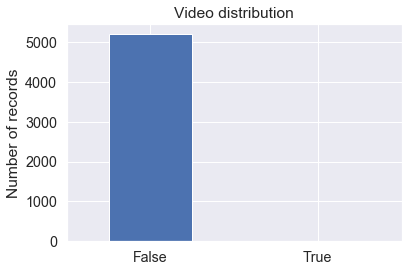

In [8]:
train_raw['video'].value_counts().plot(kind='bar')
plt.title('Video distribution')
plt.ylabel('Number of records')
plt.xticks(rotation=360)

(array([0]), <a list of 1 Text xticklabel objects>)

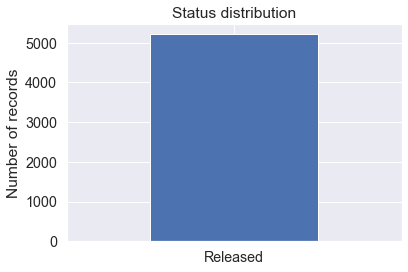

In [9]:
train_raw['status'].value_counts().plot(kind='bar')
plt.title('Status distribution')
plt.ylabel('Number of records')
plt.xticks(rotation=360)

$\bullet$ As we can see the train dataset & test dataset are in the same structure and both contain nested columns 

$\bullet$ we will unpack the nested structures later on. Those columns are all Strings.

$\bullet$ There are no duplicate rows in both datasets

$\bullet$ All movies are 'Realesed' and therfore <b>Status</b> column, containing only 1 value, has no impact and won't be in use

## Let's see some statistics about the numerical columns:

In [10]:
train_raw.describe().apply(lambda s: s.apply(lambda x: format(x, 'g')))

,budget,id,popularity,revenue,runtime,vote_average,vote_count
count,5215,5215,5215,5215,5211,5215,5215
mean,2.14797e+07,98768.7,10.0166,6.53874e+07,108.027,6.3991,1062.86
std,3.63151e+07,143993,7.0758,1.43238e+08,22.741,0.943931,2097.17
min,0,5,1.519,1,0,0,0
25%,0,10136,6.264,2.36072e+06,94,5.9,74
50%,6.5e+06,24662,9.009,1.51562e+07,104,6.4,290
75%,2.6e+07,121704,11.801,6.21425e+07,118,7.1,1028
max,3.8e+08,679106,151.237,2.04624e+09,465,10,24834


In [11]:
test_raw.describe().apply(lambda s: s.apply(lambda x: format(x, 'g')))

,budget,id,popularity,revenue,runtime,vote_average,vote_count
count,1738,1738,1738,1738,1736,1738,1738
mean,2.19667e+07,105008,10.0212,6.88059e+07,108.687,6.39614,1027.67
std,3.74423e+07,151577,8.55727,1.61447e+08,22.3713,0.902789,1993.46
min,0,6,1.508,1,0,2,1
25%,0,9944.5,6.37975,2.4047e+06,94,5.8,79
50%,7e+06,23871.5,8.855,1.53426e+07,105,6.4,287
75%,2.575e+07,139091,11.618,6.20512e+07,119,7,914.5
max,3.56e+08,637920,221.327,2.7978e+09,332,10,14471


$\bullet$ We can see that both train & test contain uncertain data - rows with runtime = 0 , budget = 0 

$\bullet$ We will treat those values as missing data and they will be imputed later on.

In [12]:
print(f"Train dataset: Amount of movies with 0 budget: {len(train_raw[train_raw['budget'] == 0])}")
print(f"Train dataset: Amount of movies with 0 runtime: {len(train_raw[train_raw['runtime'] == 0])}")
print(f"Test dataset : Amount of movies with 0 budget: {len(test_raw[test_raw['budget'] == 0])}")
print(f"Test dataset : Amount of movies with 0 budget: {len(test_raw[test_raw['runtime'] == 0])}")

Train dataset: Amount of movies with 0 budget: 1487
Train dataset: Amount of movies with 0 runtime: 12
Test dataset : Amount of movies with 0 budget: 494
Test dataset : Amount of movies with 0 budget: 2


## Features distribution & comparative analysis between features

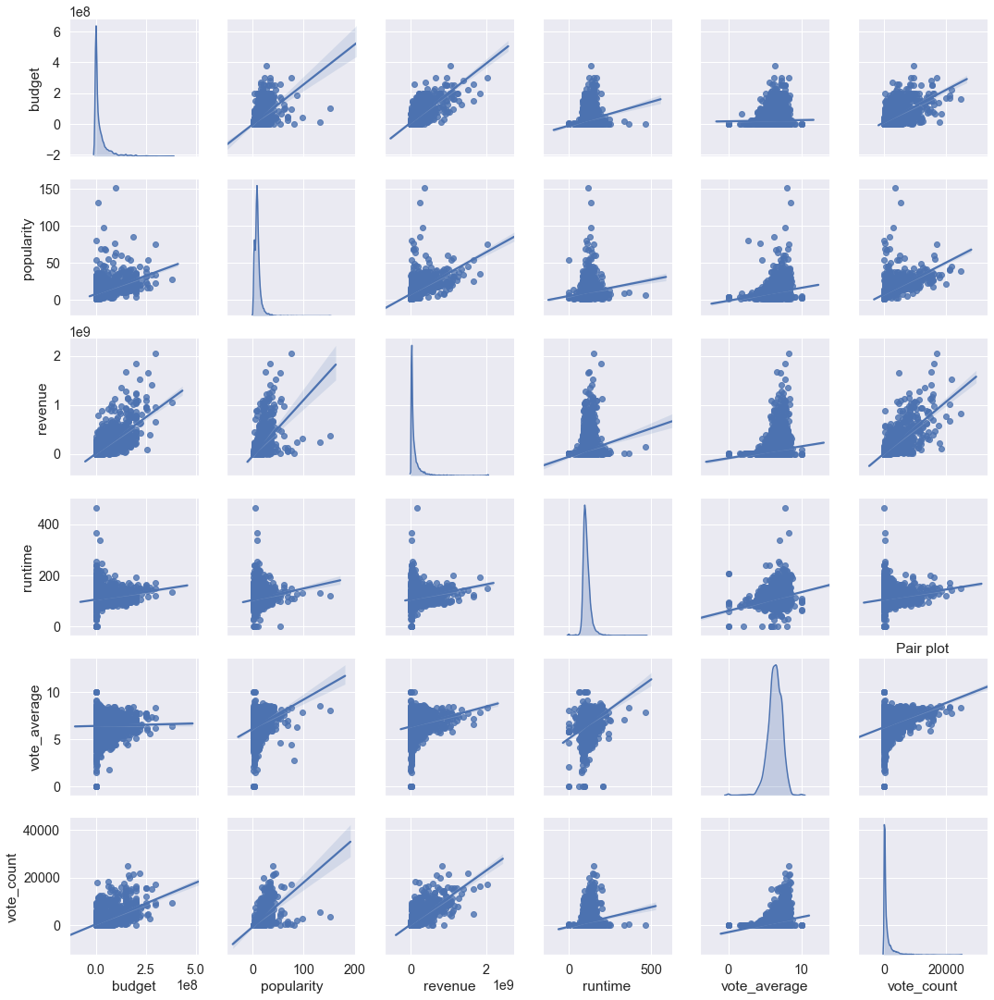

In [13]:
sns.pairplot(train_raw.select_dtypes('number').drop(columns='id'), kind="reg", diag_kind="kde")
plt.title('Pair plot')
plt.savefig('pairplot.jpg')
plt.show()

$\bullet$ In the main diagonal we can see each of the numerical column distribution

$\bullet$ From the pair-plot we can deduce info about the correlated columns :
- popullarity & vote_count
- revenue & budjet
- runtime & vote_count 
- revenue & popullarity
- ...

### Let's dig a bit deeper about about correlations with Revenue (our target column)

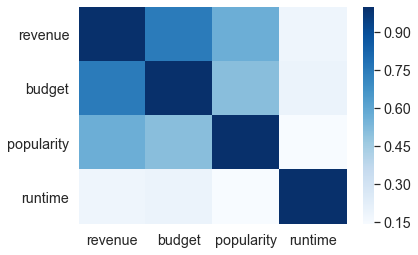

In [14]:
cols =['revenue','budget','popularity','runtime']
sns.heatmap(train_raw[cols].corr(), cmap="Blues")
plt.show()

## Missing data

In [15]:
# The raw data contains Empty values as ['[]', '{}', '']. we will replace those values with None just for an easier view 
train_na = train_raw.replace(to_replace =['[]', '{}', ''], value = np.nan)
test_na = test_raw.replace(to_replace =['[]', '{}', ''], value = np.nan)

In [16]:
print ("Train missing values :")
train_na.isnull().sum().sort_values(ascending=False)

Train missing values :


belongs_to_collection    4150
homepage                 3449
tagline                  1025
backdrop_path             577
Keywords                  400
production_companies      170
poster_path               167
production_countries       48
imdb_id                    15
genres                     14
cast                       10
spoken_languages            8
crew                        7
overview                    6
runtime                     4
title                       0
video                       0
popularity                  0
release_date                0
original_title              0
original_language           0
revenue                     0
id                          0
vote_average                0
budget                      0
vote_count                  0
status                      0
dtype: int64

In [17]:
print ("Test missing values :")
test_na.isnull().sum().sort_values(ascending=False)

Test missing values :


belongs_to_collection    1384
homepage                 1131
tagline                   346
backdrop_path             170
Keywords                  137
production_companies       52
poster_path                50
production_countries       11
cast                        7
spoken_languages            5
genres                      5
crew                        3
runtime                     2
imdb_id                     1
overview                    1
video                       0
popularity                  0
title                       0
original_title              0
original_language           0
release_date                0
id                          0
vote_average                0
revenue                     0
budget                      0
vote_count                  0
status                      0
dtype: int64

$\bullet$ The feature <b>'belongs_to_collection'</b> contains many None's. That makes sense because most the movies are not part of a collection 

$\bullet$ The features <b>'homepage'</b> & <b>'tagline'</b> also has many None values.
That makes them preaty unrelevant for out task because if imputation is required (not necessarily) we won't be able to apply it without additional data. Also the percentage of None values is ~50% & ~20% accordingly (high numbers)

$\bullet$ The features <b>'backdrop_path'</b> & <b>'poster_path'</b> refer to images which are irrelevant for our task 



# Feature Engineering

## Unpack nested columns
First, we should unpack all the nested attrubutes in the columns.

We used <b>eval</b> to convert the string representation of an attrubutes to an object.
Following, we extracted the relevant information (in our opinion) from each column as follows:

- `belongs_to_collection_ids` : If a movie belongs to a collection - we keep the collection id, else None.
- `genres` : The genre `name` attributes
- `production_comapnies_names` & `production_comapnies_origin_country` : List of production company names attribute & production companies origin country.
- `production_countries` : List of countries (`iso_3166`) where the movie was filmed.
- `release_month`, `release_year` : The month & year the film was released on.
- `spoken_languages_len` : Number of spoken languages in the movie (`iso_639` attribute).
- `Keywords_names` : List of name attribute for each Keyword.
- `cast_len` : Number of members in the cast.
- `crew` : We created a column for each department in the dataset(there are 12).
In each column you can find the numbers of members in the crew from the fitting department.
- `crew_directors_names` - A column that contains a tuple of each of the director's names


In [18]:
cols_to_drop = ['backdrop_path', 'homepage', 'imdb_id', 'original_title', 'poster_path', 'status', 'video']
train_raw = drop_column(train_raw, cols_to_drop)
test_raw = drop_column(test_raw, cols_to_drop)

We threw all the columns we had not used at all.

In [19]:
flatten_train_df, set_of_departments = flatten_features(train_raw, 'train')
flatten_test_df, _ = flatten_features(test_raw, 'test')

In [20]:
flatten_train_df.head()

,budget,genres,id,original_language,overview,popularity,production_countries,revenue,runtime,spoken_languages,tagline,title,vote_average,vote_count,belongs_to_collection_ids,production_companies_names,production_companies_origin_country,production_countries_iso,release_month,release_year,spoken_languages_len,Keywords_names,cast_names,cast_len,cast_genders,crew_directors_names,Actors,Art,Camera,Costume & Make-Up,Crew,Directing,Editing,Lighting,Production,Sound,Visual Effects,Writing
0,258000000,"(Fantasy, Action, Adventure)",559,en,The seemingly invincible Spider-Man goes up ag...,22.024,"[{'iso_3166_1': 'US', 'name': 'United States o...",890871626,139.0,"(en, fr)",The battle within.,Spider-Man 3,6.2,8180,556,"(Marvel Enterprises, Columbia Pictures, Laura ...","(US, US, , US)","(US,)",5,2007,2,"(loss of loved one, dual identity, amnesia, sa...","(Tobey Maguire, Kirsten Dunst, James Franco, T...",137,"(2, 1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, ...","(Sam Raimi,)",0,19,3,2,1,2,1,0,23,1,0,5
1,250000,"(Comedy, Horror)",50719,en,After being traumatized by his brother Billy's...,4.756,"[{'iso_3166_1': 'US', 'name': 'United States o...",154323,88.0,"(en,)",The nightmare is about to begin ... AGAIN!,"Silent Night, Deadly Night Part 2",4.3,68,256296,"(Silent Night Releasing Corporation,)","(,)","(US,)",4,1987,1,"(holiday, santa claus, sequel, murder, serial ...","(Eric Freeman, James Newman, Elizabeth Kaitan,...",52,"(2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, ...","(Lee Harry,)",0,0,1,0,2,1,1,0,1,1,0,8
2,0,"(Documentary,)",469062,en,A deliciously scandalous portrait of unsung Ho...,4.746,"[{'iso_3166_1': 'US', 'name': 'United States o...",176236,98.0,"(en,)",NaN,Scotty and the Secret History of Hollywood,6.5,15,NaN,"(Water's End Productions,)","(US,)","(US,)",7,2018,1,"(lgbt,)","(Scotty Bowers, Peter Bart, William Mann, Robe...",7,"(2, 2, 0, 0, 2, 2, 1)","(Matt Tyrnauer,)",0,1,6,0,4,1,16,0,20,9,0,0
3,1000000,"(Horror,)",9003,en,An unfaithful wife encounters the zombie of he...,13.828,"[{'iso_3166_1': 'GB', 'name': 'United Kingdom'}]",14564027,94.0,"(en,)",He'll tear your soul apart.,Hellraiser,6.9,1115,8917,"(New World Pictures, Cinemarque Entertainment ...","(, , , )","(GB,)",9,1987,1,"(underworld, seduction, supernatural, revenge,...","(Andrew Robinson, Clare Higgins, Ashley Lauren...",22,"(2, 1, 1, 2, 2, 2, 0, 0, 2, 0, 2, 0, 2, 2, 2, ...","(Clive Barker,)",0,5,4,7,20,6,3,3,9,8,4,2
4,15000000,"(Comedy, Adventure)",11153,en,Clark Griswold is on a quest to take his famil...,15.070,"[{'iso_3166_1': 'US', 'name': 'United States o...",61399552,99.0,"(en,)",Every summer Chevy Chase takes his family on a...,National Lampoon's Vacation,7.1,782,108693,"(Warner Bros. Pictures,)","(US,)","(US,)",7,1983,1,"(relatives, road trip, domestic life, family v...","(Chevy Chase, Beverly D'Angelo, Imogene Coca, ...",24,"(2, 1, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, ...","(Harold Ramis,)",0,0,1,0,0,1,1,0,1,1,0,1


In [21]:
flatten_test_df.head()

,budget,genres,id,original_language,overview,popularity,production_countries,revenue,runtime,spoken_languages,tagline,title,vote_average,vote_count,belongs_to_collection_ids,production_companies_names,production_companies_origin_country,production_countries_iso,release_month,release_year,spoken_languages_len,Keywords_names,cast_names,cast_len,cast_genders,crew_directors_names,Actors,Art,Camera,Costume & Make-Up,Crew,Directing,Editing,Lighting,Production,Sound,Visual Effects,Writing
0,58000000,"(Horror, Science Fiction, Thriller)",395992,en,The six-member crew of the International Space...,17.409,"[{'iso_3166_1': 'US', 'name': 'United States o...",100541806,103.0,"(cn, en, ja)",Be careful what you search for,Life,6.4,4738,NaN,"(Columbia Pictures, Nvizage, Sony Pictures, Sk...","(US, , US, US)","(US,)",3,2017,3,"(planet mars, alien life-form, space, astronau...","(Jake Gyllenhaal, Rebecca Ferguson, Ryan Reyno...",16,"(2, 1, 2, 2, 2, 1, 0, 0, 0, 1, 1, 2, 0, 0, 0, 1)","(Daniel Espinosa,)",0,11,6,7,8,5,3,0,10,11,19,2
1,0,"(Comedy, Crime, Drama)",20832,hi,A psychiatrist spends the majority of his time...,2.257,"[{'iso_3166_1': 'IN', 'name': 'India'}]",8000000,110.0,"(hi,)",NaN,Krazzy 4,4.6,19,NaN,"(Film Kraft,)","(,)","(IN,)",4,2008,1,None,"(Arshad Warsi, Irrfan Khan, Suresh Menon, Rajp...",11,"(2, 2, 0, 2, 1, 1, 1, 2, 2, 2, 2)","(Jaideep Sen,)",0,1,1,1,2,1,1,0,4,2,0,2
2,0,"(Romance, Animation, Family, Comedy, Adventure)",15789,en,"Though Goofy always means well, his amiable cl...",13.558,"[{'iso_3166_1': 'FR', 'name': 'France'}, {'iso...",35348597,78.0,"(en,)",It’s hard to be cool... when your dad’s Goofy.,A Goofy Movie,6.9,964,410261,"(Disney Television Animation, Walt Disney Anim...","(US, FR)","(FR, US)",4,1995,1,"(parent child relationship, pop singer, musica...","(Bill Farmer, Jason Marsden, Rob Paulsen, Jim ...",17,"(2, 2, 2, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 2, ...","(Kevin Lima, Paul Brizzi)",0,1,0,0,2,2,1,0,3,8,2,4
3,4000000,"(Drama,)",265180,ru,"In a Russian coastal town, Kolya is forced to ...",7.158,"[{'iso_3166_1': 'RU', 'name': 'Russia'}]",4396821,141.0,"(ru,)",NaN,Leviathan,7.5,447,NaN,"(Non-Stop Productions,)","(RU,)","(RU,)",9,2014,1,"(small town, mayor, car mechanic, political co...","(Aleksey Serebryakov, Elena Lyadova, Vladimir ...",21,"(2, 1, 0, 2, 1, 0, 2, 2, 2, 0, 1, 0, 2, 2, 2, ...","(Andrey Zvyagintsev,)",0,3,3,2,2,1,1,3,6,5,2,2
4,250000,"(Comedy, Drama)",10098,en,A tramp cares for a boy after he's abandoned a...,10.523,"[{'iso_3166_1': 'US', 'name': 'United States o...",2500000,68.0,"(xx,)",6 reels of Joy.,The Kid,8.2,1008,NaN,"(First National Pictures, Charles Chaplin Prod...","(US, )","(US,)",2,1921,1,"(angel, suicide attempt, fistfight, slapstick,...","(Charlie Chaplin, Jackie Coogan, Edna Purvianc...",35,"(2, 2, 1, 2, 2, 0, 0, 2, 0, 2, 1, 0, 0, 0, 0, ...","(Charlie Chaplin,)",0,1,2,0,2,3,1,0,1,1,0,1


## Our features:

- `collection_size` : The amount of movies in the collection (1 if the movie is not part of a collection) - will derive from `belongs_to_collection` column.
- `budget` : The budget column in a normelize form (log/ min-max normalization)
- `[gener name]` : Dummy column for each gener (19 geners in the universe)
- `[language]` : Dummy column for the 5 most frequent movie's original languages in our universe
- `overview_word_count` : Amount of words in overview
- `popularity` : The popularity column in a normelize form (min-max normalization)
- `[production company id]` : Dummy column for the 5 most frequent movie's production companies
- `num_films_of_biggest_company` : The numbers of films that the biggest production company (The one with the hightes number of films) that participates in this movie has produced (From the currect universe)
- `num_films_of_biggest_country` : The numbers of films that the biggest production country (The one with the hightes number of films) that participates in this movie has produced (From the currect universe)
- `release_year` : The year that the movie was realed on
- `release_month` : The month that the movie was realed on
- `runtime` : The moview lenth in minutes, normelized (min-max normalization)
- `spoken_lang_len` : The amount of spoken languages in a film.
- `is_english_spoken` : Binary column, 1 if English is one of tthe spoken langueges and 0 otherwize.
- `tagline_char_count` : The length (characters) of a tagline.
- `title_char_count` : The length (characters) of a title.
- `sum_votes` : The sum of votes for the movie(calculated by vote_avg * vote_count), in a normelized form (min-max normalization).
- `[Keywords]` : There are ~10,000 unique keywords in train data, so we will create dummy column for each of the top 20 most-frequent keywords in the universe.
- `cast_len` : The nubmer of members in the cast, in a normelized form (min-max normalization).
- `cast_genders_ratio` : The gender ratio (`Females / Females + Males`) of cast.
- `[actor name]` : Dummy column for the 10 most frequent actors in our universe
- `[department name]` : The nubmer of members in the each department, in a normelized form (min-max normalization).
- `[director name]` : Dummy column for the 10 most frequent directors in our universe
- `avg_popularity_by_year` : Mean popularity of films in the released year of a movie.

* Overall we added 81 dummies


In [22]:
extracted_train = extract_features(flatten_train_df, set_of_departments, 'train')
extracted_train.head()

,budget,id,popularity,revenue,runtime,vote_average,vote_count,belongs_to_collection_ids,release_month,release_year,spoken_languages_len,cast_len,Actors,Art,Camera,Costume & Make-Up,Crew,Directing,Editing,Lighting,Production,Sound,Visual Effects,Writing,collection_size,overview_word_count,num_films_of_biggest_company,num_films_of_biggest_country,is_english_spoken,tagline_char_count,title_char_count,sum_votes,cast_genders_ratio,avg_popularity_by_year,spoken_languages_en,spoken_languages_fr,spoken_languages_es,spoken_languages_de,spoken_languages_it,production_companies_names_Warner Bros. Pictures,production_companies_names_Universal Pictures,production_companies_names_Paramount,production_companies_names_Columbia Pictures,production_companies_names_20th Century Fox,Keywords_names_based on novel or book,Keywords_names_woman director,Keywords_names_murder,Keywords_names_duringcreditsstinger,"Keywords_names_new york city, usa",Keywords_names_violence,Keywords_names_biography,Keywords_names_based on a true story,Keywords_names_sequel,Keywords_names_independent film,Keywords_names_revenge,Keywords_names_love,Keywords_names_friendship,Keywords_names_parent child relationship,Keywords_names_police,Keywords_names_sport,Keywords_names_sibling relationship,Keywords_names_dystopia,Keywords_names_teenager,Keywords_names_aftercreditsstinger,cast_names_Samuel L. Jackson,cast_names_Frank Welker,cast_names_Morgan Freeman,cast_names_Bruce Willis,cast_names_Steve Buscemi,cast_names_Robert De Niro,cast_names_Nicolas Cage,cast_names_John Goodman,cast_names_Liam Neeson,cast_names_Willem Dafoe,crew_directors_names_Clint Eastwood,crew_directors_names_Steven Spielberg,crew_directors_names_Ridley Scott,crew_directors_names_Robert Rodriguez,crew_directors_names_Alfred Hitchcock,crew_directors_names_Ron Howard,crew_directors_names_Woody Allen,crew_directors_names_Richard Donner,crew_directors_names_Steven Soderbergh,crew_directors_names_Sidney Lumet,genres_Drama,genres_Comedy,genres_Thriller,genres_Action,genres_Romance,genres_Adventure,genres_Crime,genres_Horror,genres_Science Fiction,genres_Family,genres_Fantasy,genres_Mystery,genres_Animation,genres_History,genres_Music,genres_War,genres_Documentary,genres_Western,genres_TV Movie
0,0.678947,559,0.136957,890871626,0.298925,6.2,8180,556,5,2007,2,0.614350,0.0,0.128378,0.044776,0.015152,0.002985,0.074074,0.032258,0.000000,0.193277,0.010753,0.00000,0.217391,2,43,256,3917,1,18,12,0.246048,0.611111,9.319018,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0
1,0.000658,50719,0.021621,154323,0.189247,4.3,68,256296,4,1987,1,0.233184,0.0,0.000000,0.014925,0.000000,0.005970,0.037037,0.032258,0.000000,0.008403,0.010753,0.00000,0.347826,1,48,1,3917,1,42,33,0.001419,0.416667,8.119851,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,0.000000,469062,0.021554,176236,0.210753,6.5,15,NaN,7,2018,1,0.031390,0.0,0.006757,0.089552,0.000000,0.011940,0.037037,0.516129,0.000000,0.168067,0.096774,0.00000,0.000000,1,23,1,3917,1,0,42,0.000473,0.200000,14.132214,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,0.002632,9003,0.082215,14564027,0.202151,6.9,1115,8917,9,1987,1,0.098655,0.0,0.033784,0.059701,0.053030,0.059701,0.222222,0.096774,0.030303,0.075630,0.086022,0.01487,0.086957,2,23,10,671,1,27,10,0.037325,0.230769,8.119851,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
4,0.039474,11153,0.090510,61399552,0.212903,7.1,782,108693,7,1983,1,0.107623,0.0,0.000000,0.014925,0.000000,0.000000,0.037037,0.032258,0.000000,0.008403,0.010753,0.00000,0.043478,2,28,344,3917,1,86,27,0.026936,0.272727,7.817860,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [23]:
extracted_test = extract_features(flatten_test_df, set_of_departments, 'test')
extracted_test.head()

,budget,id,popularity,revenue,runtime,vote_average,vote_count,belongs_to_collection_ids,release_month,release_year,spoken_languages_len,cast_len,Actors,Art,Camera,Costume & Make-Up,Crew,Directing,Editing,Lighting,Production,Sound,Visual Effects,Writing,collection_size,overview_word_count,num_films_of_biggest_company,num_films_of_biggest_country,is_english_spoken,tagline_char_count,title_char_count,sum_votes,cast_genders_ratio,avg_popularity_by_year,spoken_languages_en,spoken_languages_fr,spoken_languages_es,spoken_languages_de,spoken_languages_it,production_companies_names_Warner Bros. Pictures,production_companies_names_Universal Pictures,production_companies_names_Paramount,production_companies_names_Columbia Pictures,production_companies_names_20th Century Fox,Keywords_names_based on novel or book,Keywords_names_woman director,Keywords_names_murder,Keywords_names_duringcreditsstinger,"Keywords_names_new york city, usa",Keywords_names_violence,Keywords_names_biography,Keywords_names_based on a true story,Keywords_names_sequel,Keywords_names_independent film,Keywords_names_revenge,Keywords_names_love,Keywords_names_friendship,Keywords_names_parent child relationship,Keywords_names_police,Keywords_names_sport,Keywords_names_sibling relationship,Keywords_names_dystopia,Keywords_names_teenager,Keywords_names_aftercreditsstinger,cast_names_Samuel L. Jackson,cast_names_Frank Welker,cast_names_Morgan Freeman,cast_names_Bruce Willis,cast_names_Steve Buscemi,cast_names_Robert De Niro,cast_names_Nicolas Cage,cast_names_John Goodman,cast_names_Liam Neeson,cast_names_Willem Dafoe,crew_directors_names_Clint Eastwood,crew_directors_names_Steven Spielberg,crew_directors_names_Ridley Scott,crew_directors_names_Robert Rodriguez,crew_directors_names_Alfred Hitchcock,crew_directors_names_Ron Howard,crew_directors_names_Woody Allen,crew_directors_names_Richard Donner,crew_directors_names_Steven Soderbergh,crew_directors_names_Sidney Lumet,genres_Drama,genres_Comedy,genres_Thriller,genres_Action,genres_Romance,genres_Adventure,genres_Crime,genres_Horror,genres_Science Fiction,genres_Family,genres_Fantasy,genres_Mystery,genres_Animation,genres_History,genres_Music,genres_War,genres_Documentary,genres_Western,genres_TV Movie
0,0.162921,395992,0.072337,100541806,0.310241,6.4,4738,NaN,3,2017,3,0.099379,0.0,0.134146,0.095238,0.0875,0.042781,0.166667,0.176471,0.000,0.097087,0.177419,0.059937,0.08,1,32,86,1293,1,30,4,0.260963,0.500000,11.716723,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0
1,0.000000,20832,0.003407,8000000,0.331325,4.6,19,NaN,4,2008,1,0.068323,0.0,0.012195,0.015873,0.0125,0.010695,0.033333,0.058824,0.000,0.038835,0.032258,0.000000,0.08,1,28,1,66,0,0,8,0.000735,0.300000,9.763456,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
2,0.000000,15789,0.054818,35348597,0.234940,6.9,964,410261,4,1995,1,0.105590,0.0,0.012195,0.000000,0.0000,0.010695,0.066667,0.058824,0.000,0.029126,0.129032,0.006309,0.16,1,84,2,1293,1,46,13,0.057231,0.235294,10.640065,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,0,1,0,0,1,0,0,0,0,0,0
3,0.011236,265180,0.025703,4396821,0.424699,7.5,447,NaN,9,2014,1,0.130435,0.0,0.036585,0.047619,0.0250,0.010695,0.033333,0.058824,0.075,0.058252,0.080645,0.006309,0.08,1,42,2,30,0,0,9,0.028836,0.352941,9.930731,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0.000702,10098,0.041011,2500000,0.204819,8.2,1008,NaN,2,1921,1,0.217391,0.0,0.012195,0.031746,0.0000,0.010695,0.100000,0.058824,0.000,0.009709,0.016129,0.000000,0.04,1,31,1,1293,0,15,7,0.071122,0.357143,10.523000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0

## Some more EDA before after flattning the df and extraction of features
- How many movies do we have in each year, month? 

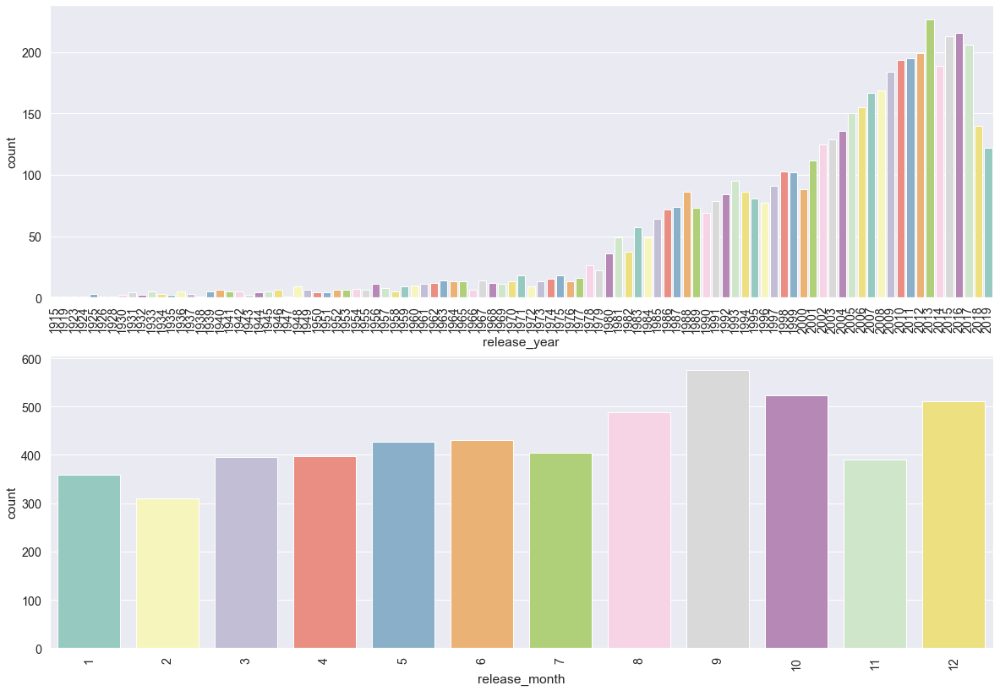

In [24]:
plt.figure(figsize=(20, 14))
plt.subplot(2, 1, 1)
sns.countplot(extracted_train['release_year'], palette="Set3")
plt.xticks(rotation=90)
plt.subplot(2, 1, 2)
sns.countplot(extracted_train['release_month'],palette="Set3")
plt.xticks(rotation=90)
plt.show()

## Handling missing data

We used KNN (`k = 5, Euclidean distance`) Imputation to find budget & runtime for films with zero values.

In [25]:
imputated_train =  imputation(extracted_train)
imputated_test =  imputation(extracted_test)

In [26]:
imputated_train.head()

,budget,id,popularity,revenue,runtime,vote_average,vote_count,belongs_to_collection_ids,release_month,release_year,spoken_languages_len,cast_len,Actors,Art,Camera,Costume & Make-Up,Crew,Directing,Editing,Lighting,Production,Sound,Visual Effects,Writing,collection_size,overview_word_count,num_films_of_biggest_company,num_films_of_biggest_country,is_english_spoken,tagline_char_count,title_char_count,sum_votes,cast_genders_ratio,avg_popularity_by_year,spoken_languages_en,spoken_languages_fr,spoken_languages_es,spoken_languages_de,spoken_languages_it,production_companies_names_Warner Bros. Pictures,production_companies_names_Universal Pictures,production_companies_names_Paramount,production_companies_names_Columbia Pictures,production_companies_names_20th Century Fox,Keywords_names_based on novel or book,Keywords_names_woman director,Keywords_names_murder,Keywords_names_duringcreditsstinger,"Keywords_names_new york city, usa",Keywords_names_violence,Keywords_names_biography,Keywords_names_based on a true story,Keywords_names_sequel,Keywords_names_independent film,Keywords_names_revenge,Keywords_names_love,Keywords_names_friendship,Keywords_names_parent child relationship,Keywords_names_police,Keywords_names_sport,Keywords_names_sibling relationship,Keywords_names_dystopia,Keywords_names_teenager,Keywords_names_aftercreditsstinger,cast_names_Samuel L. Jackson,cast_names_Frank Welker,cast_names_Morgan Freeman,cast_names_Bruce Willis,cast_names_Steve Buscemi,cast_names_Robert De Niro,cast_names_Nicolas Cage,cast_names_John Goodman,cast_names_Liam Neeson,cast_names_Willem Dafoe,crew_directors_names_Clint Eastwood,crew_directors_names_Steven Spielberg,crew_directors_names_Ridley Scott,crew_directors_names_Robert Rodriguez,crew_directors_names_Alfred Hitchcock,crew_directors_names_Ron Howard,crew_directors_names_Woody Allen,crew_directors_names_Richard Donner,crew_directors_names_Steven Soderbergh,crew_directors_names_Sidney Lumet,genres_Drama,genres_Comedy,genres_Thriller,genres_Action,genres_Romance,genres_Adventure,genres_Crime,genres_Horror,genres_Science Fiction,genres_Family,genres_Fantasy,genres_Mystery,genres_Animation,genres_History,genres_Music,genres_War,genres_Documentary,genres_Western,genres_TV Movie
0,0.678947,559.0,0.136957,890871626.0,0.298925,6.2,8180.0,556.0,5.0,2007.0,2.0,0.614350,0.0,0.128378,0.044776,0.015152,0.002985,0.074074,0.032258,0.000000,0.193277,0.010753,0.00000,0.217391,2.0,43.0,256.0,3917.0,1.0,18.0,12.0,0.246048,0.611111,9.319018,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.000658,50719.0,0.021621,154323.0,0.189247,4.3,68.0,256296.0,4.0,1987.0,1.0,0.233184,0.0,0.000000,0.014925,0.000000,0.005970,0.037037,0.032258,0.000000,0.008403,0.010753,0.00000,0.347826,1.0,48.0,1.0,3917.0,1.0,42.0,33.0,0.001419,0.416667,8.119851,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.031838,469062.0,0.021554,176236.0,0.210753,6.5,15.0,0.0,7.0,2018.0,1.0,0.031390,0.0,0.006757,0.089552,0.000000,0.011940,0.037037,0.516129,0.000000,0.168067,0.096774,0.00000,0.000000,1.0,23.0,1.0,3917.0,1.0,0.0,42.0,0.000473,0.200000,14.132214,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.002632,9003.0,0.082215,14564027.0,0.202151,6.9,1115.0,8917.0,9.0,1987.0,1.0,0.098655,0.0,0.033784,0.059701,0.053030,0.059701,0.222222,0.096774,0.030303,0.075630,0.086022,0.0

In [27]:
imputated_test.head()

,budget,id,popularity,revenue,runtime,vote_average,vote_count,belongs_to_collection_ids,release_month,release_year,spoken_languages_len,cast_len,Actors,Art,Camera,Costume & Make-Up,Crew,Directing,Editing,Lighting,Production,Sound,Visual Effects,Writing,collection_size,overview_word_count,num_films_of_biggest_company,num_films_of_biggest_country,is_english_spoken,tagline_char_count,title_char_count,sum_votes,cast_genders_ratio,avg_popularity_by_year,spoken_languages_en,spoken_languages_fr,spoken_languages_es,spoken_languages_de,spoken_languages_it,production_companies_names_Warner Bros. Pictures,production_companies_names_Universal Pictures,production_companies_names_Paramount,production_companies_names_Columbia Pictures,production_companies_names_20th Century Fox,Keywords_names_based on novel or book,Keywords_names_woman director,Keywords_names_murder,Keywords_names_duringcreditsstinger,"Keywords_names_new york city, usa",Keywords_names_violence,Keywords_names_biography,Keywords_names_based on a true story,Keywords_names_sequel,Keywords_names_independent film,Keywords_names_revenge,Keywords_names_love,Keywords_names_friendship,Keywords_names_parent child relationship,Keywords_names_police,Keywords_names_sport,Keywords_names_sibling relationship,Keywords_names_dystopia,Keywords_names_teenager,Keywords_names_aftercreditsstinger,cast_names_Samuel L. Jackson,cast_names_Frank Welker,cast_names_Morgan Freeman,cast_names_Bruce Willis,cast_names_Steve Buscemi,cast_names_Robert De Niro,cast_names_Nicolas Cage,cast_names_John Goodman,cast_names_Liam Neeson,cast_names_Willem Dafoe,crew_directors_names_Clint Eastwood,crew_directors_names_Steven Spielberg,crew_directors_names_Ridley Scott,crew_directors_names_Robert Rodriguez,crew_directors_names_Alfred Hitchcock,crew_directors_names_Ron Howard,crew_directors_names_Woody Allen,crew_directors_names_Richard Donner,crew_directors_names_Steven Soderbergh,crew_directors_names_Sidney Lumet,genres_Drama,genres_Comedy,genres_Thriller,genres_Action,genres_Romance,genres_Adventure,genres_Crime,genres_Horror,genres_Science Fiction,genres_Family,genres_Fantasy,genres_Mystery,genres_Animation,genres_History,genres_Music,genres_War,genres_Documentary,genres_Western,genres_TV Movie
0,0.162921,395992.0,0.072337,100541806.0,0.310241,6.4,4738.0,0.0,3.0,2017.0,3.0,0.099379,0.0,0.134146,0.095238,0.0875,0.042781,0.166667,0.176471,0.000,0.097087,0.177419,0.059937,0.08,1.0,32.0,86.0,1293.0,1.0,30.0,4.0,0.260963,0.500000,11.716723,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.051994,20832.0,0.003407,8000000.0,0.331325,4.6,19.0,0.0,4.0,2008.0,1.0,0.068323,0.0,0.012195,0.015873,0.0125,0.010695,0.033333,0.058824,0.000,0.038835,0.032258,0.000000,0.08,1.0,28.0,1.0,66.0,0.0,0.0,8.0,0.000735,0.300000,9.763456,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.103933,15789.0,0.054818,35348597.0,0.234940,6.9,964.0,410261.0,4.0,1995.0,1.0,0.105590,0.0,0.012195,0.000000,0.0000,0.010695,0.066667,0.058824,0.000,0.029126,0.129032,0.006309,0.16,1.0,84.0,2.0,1293.0,1.0,46.0,13.0,0.057231,0.235294,10.640065,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.011236,265180.0,0.025703,4396821.0,0.424699,7.5,447.0,0.0,9.0,2014.0,1.0,0.130435,0.0,0.036585,0.047619,0.0250,0.010695,0.033333,0.058824,0.075,0.058252,0.080645,0.006309,0.08,1.0,42.0,2.0,30.0,0.0

## Prediction

We tried multiple models.. We decided to show 3 of the models that got the best scores -  xgboost, lightgbm and RandomForestRegressor
- For each model, we did the hyperparameter tuning & CV with RandomizedSearchCV module which is implemented as part of sklearn.model_selection. RandomizedSearchCV tune the hyperparameter by cross-validated (5 folds) search over parameter settings. It chooses n_candidates (10) from the given ranges.
- Due to long runtimes when trying to find the best hyperparameters for each model, we chose a sample of parameters to tune:

- <b> XGBoost </b> :
- `max_depth` :range(5, 7),
- `min_child_weight`:range(2, 4),
- `n_estimators`: range(750, 1000),                       
- `reg_alpha`: range(2, 4)

- <b> LGBMRegressor </b> :
- `max_depth` :range(-1, 5),          
- `min_child_weight`:range(0, 1),      
- `n_estimators`: range(100, 500),

- <b> RandomForest </b> :
- `n_estimators` : range(1000,1500)                        
- `max_depth` : range(10,50)


- The chosen parametes for each model will be presented below.
- The validation is performed with the hyper parameter tuning.
- The models performance were measured by the RMSLE measurment. We will present the best results that each model was able to achieve according to the measurment & hyperparameters
- For our chosen model (XGBRegressor) we plot a feature importance graph 

In [28]:
Y_train = imputated_train['revenue']
X_train = imputated_train.drop(['revenue', 'id'], axis=1)
Y_test = imputated_test['revenue']
X_test = imputated_test.drop(['revenue', 'id'], axis=1)

## Hyperparameter selection
- We couldn't tune all the params.. so we chose some of the defualt\ known best params for our mission

In [86]:
def tune_params(model, params,x_train,y_train): 
    tuned_model = RandomizedSearchCV(estimator=model, param_distributions=params, n_iter = 10,
                                scoring='neg_mean_squared_log_error', verbose=2, random_state=42,
                                n_jobs=-1, return_train_score=True)

    tuned_model.fit(x_train, y_train) 
    print(tuned_model.best_params_)
    return tuned_model.best_params_

def train_model(train, label, model, model_name):
    model.fit(train, np.log1p(label))
    with open(f'models/{model_name}.pkl', 'wb') as f:
        pickle.dump(model, f)
    predictions = np.expm1(model.predict(train))
    RMSLE = np.sqrt(mean_squared_log_error(label, predictions))
    print(f"RMSLE for train dataset for {model_name} model is: {round(RMSLE, 4)}")
    return model

def evaluate_model(test, label, trained_model, model_name):
    if model_name == 'xgb':
        xgb.plot_importance(trained_model, max_num_features=10)
        plt.rcParams["figure.figsize"] = (25, 8)
        plt.show()
    predictions = np.expm1(trained_model.predict(test))
    RMSLE = np.sqrt(mean_squared_log_error(label, predictions))
    print(f"RMSLE for test dataset for {model_name} model is: {round(RMSLE, 4)}")
    return predictions

## LBG

In [32]:
lgb_params = {'boosting_type': 'gbdt',
                'class_weight': None,
                'colsample_bytree': 1.0,
                'importance_type': 'split',
                'learning_rate': 0.1,
                'min_child_samples': 20,
                'min_split_gain': 0.0,
                'n_jobs': -1,
                'num_leaves': 31,
                'objective': 'regression',
                'random_state': None,
                'reg_alpha': 0.0,
                'reg_lambda': 0.0,
                'silent': True,
                'subsample': 1.0,
                'subsample_for_bin': 200000,
                'subsample_freq': 0,
                'max_depth':-1,
                'min_child_weight': 0.04,
                'n_estimators': 100}

X = X_train.rename(columns=lambda x: re.sub('[^A-Za-z0-9_]+', '', x))
lgb_model = lgb.LGBMRegressor(**lgb_params)
# create tuned model
lgb_model = lgb.LGBMRegressor(**lgb_params)
# train model
lgb_model = train_model(X, Y_train, lgb_model, 'lgb')
# evaluate
X_test_lgb = X_test.rename(columns=lambda x: re.sub('[^A-Za-z0-9_]+', '', x))
lgb_predictions = evaluate_model(X_test_lgb, Y_test, lgb_model, 'lgb')

RMSLE for train dataset for lgb model is: 1.1638
RMSLE for test dataset for lgb model is: 1.8107


## Random Forest

In [30]:
from sklearn.ensemble import RandomForestRegressor
rf_params = {   'n_estimators': 1500,
                'min_samples_split': 2,
                'min_samples_leaf': 2,
                'max_features': 0.4,
                'max_depth': 50,
                'criterion': 'mae',
                'bootstrap': False  }

rf_model = RandomForestRegressor(**rf_params, n_jobs= -1)
# create tuned model
rf_model = RandomForestRegressor(**rf_params, n_jobs= -1)
# train model
rf_model = train_model(X_train, Y_train, rf_model, 'rf')
# evaluate
rf_predictions = evaluate_model(X_test, Y_test, rf_model, 'rf')

RMSLE for train dataset for rf model is: 0.5832
RMSLE for test dataset for rf model is: 1.7645


## XGBoost


RMSLE for train dataset for xgb model is: 1.2629


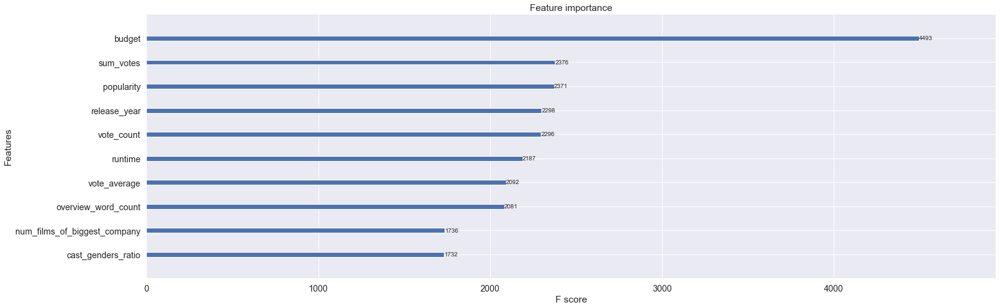

RMSLE for test dataset for xgb model is: 1.7403


In [87]:
xgb_params = {   'subsample': 0.6, 
                'reg_lambda': 10, 
                'reg_alpha': 2, 
                'objective': 'reg:squarederror', 
                'n_estimators': 1000, 
                'min_child_weight': 4, 
                'max_depth': 7, 
                'learning_rate': 0.01, 
                'gamma': 0.5, 
                'colsample_bytree': 0.6 }

# create tuned model
xgb_model = xgb.XGBRegressor(**xgb_params, n_jobs=-1)
# train model
xgb_model = train_model(X_train, Y_train, xgb_model, 'xgb')
# evaluate
xgb_predictions = evaluate_model(X_test, Y_test, xgb_model, 'xgb')

### Let's plot the predictions to see the best fit

In [66]:
df_revenue_time_series = pd.DataFrame()
df_revenue_time_series['true_label'] = list(Y_test)
df_revenue_time_series['release_year'] = list(X_test['release_year'])
df_revenue_time_series['xgb_pred'] = list(xgb_predictions)
df_revenue_time_series['lgb_pred'] = list(lgb_predictions)
df_revenue_time_series['rf_pred'] = list(rf_predictions)


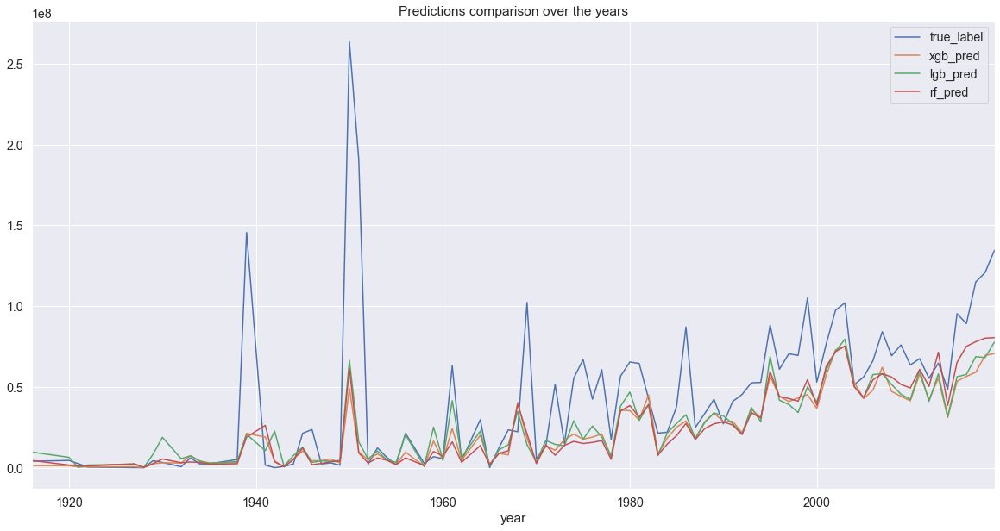

In [80]:
ax = plt.gca()
df_plot_results = df_revenue_time_series[['release_year','true_label','xgb_pred','lgb_pred','rf_pred']].groupby('release_year').mean()
df_plot_results['year'] = df_plot_results.index
plt.rcParams['figure.figsize'] = [20, 10]
plt.title('Predictions comparison over the years')
df_plot_results.plot(kind='line',x= 'year' ,y ='true_label', ax = ax)
df_plot_results.plot(kind='line',x= 'year' ,y ='xgb_pred',ax = ax)
df_plot_results.plot(kind='line',x= 'year' ,y ='lgb_pred',ax = ax)
df_plot_results.plot(kind='line',x= 'year' ,y ='rf_pred',ax = ax)


### Conclusions
- As you can see, the evaluation results for the 3 models were pretty similar.
- We chose our final model to be XGBRegressor because it got the lowest RMSLE
- From the feature importance graph we can learn wich features affects most on the model